## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---
## First, I'll compute the camera calibration using chessboard images

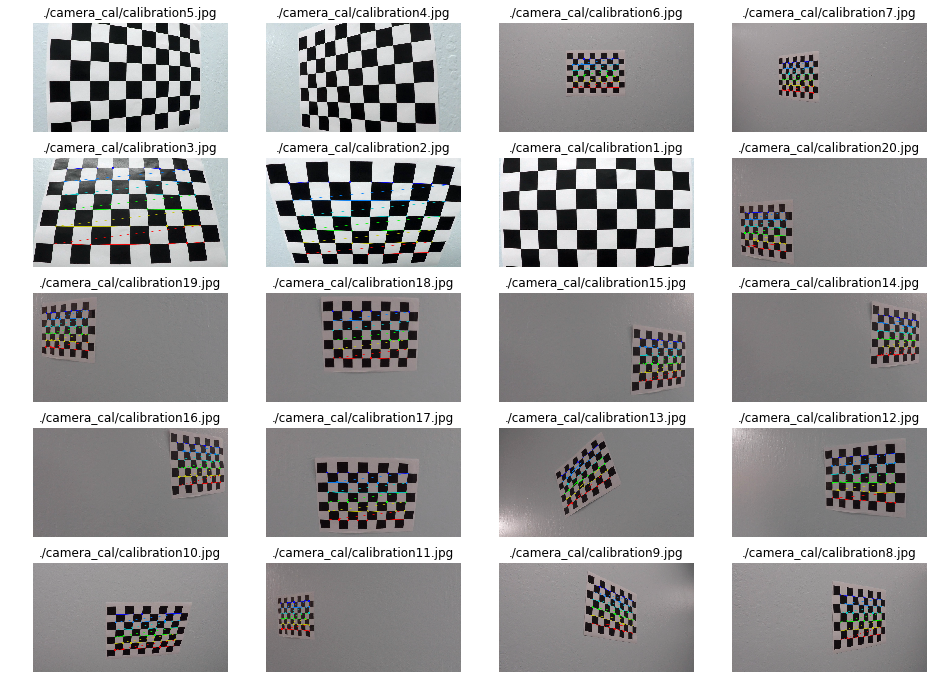

In [4]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
%matplotlib inline

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(8,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('./camera_cal/calibration*.jpg')

plt.figure(figsize=(16, 12))
i = 1
# Step through the list and search for chessboard corners
for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        cv2.imshow('img',img)
    plt.subplot(5, 4, i)
    i += 1
    plt.axis('off')
    plt.title(fname)
    plt.imshow(img)

plt.show()
cv2.destroyAllWindows()

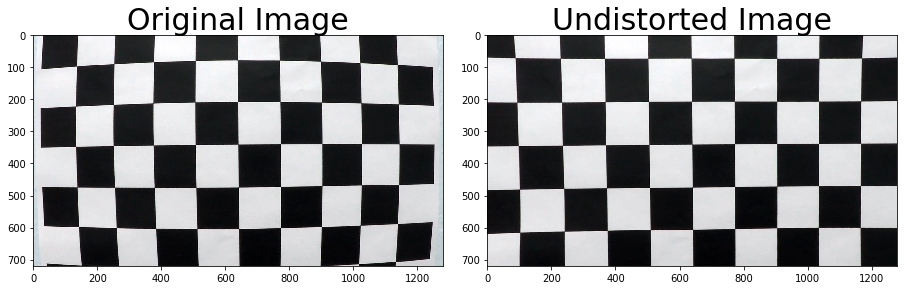

In [9]:
img = cv2.imread('./camera_cal/calibration1.jpg')

gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(
    objpoints, imgpoints, gray.shape[::-1], None, None)
undistorted = cv2.undistort(img, mtx, dist, None, mtx)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(undistorted)
ax2.set_title('Undistorted Image', fontsize=30)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


## Undistort Test Images

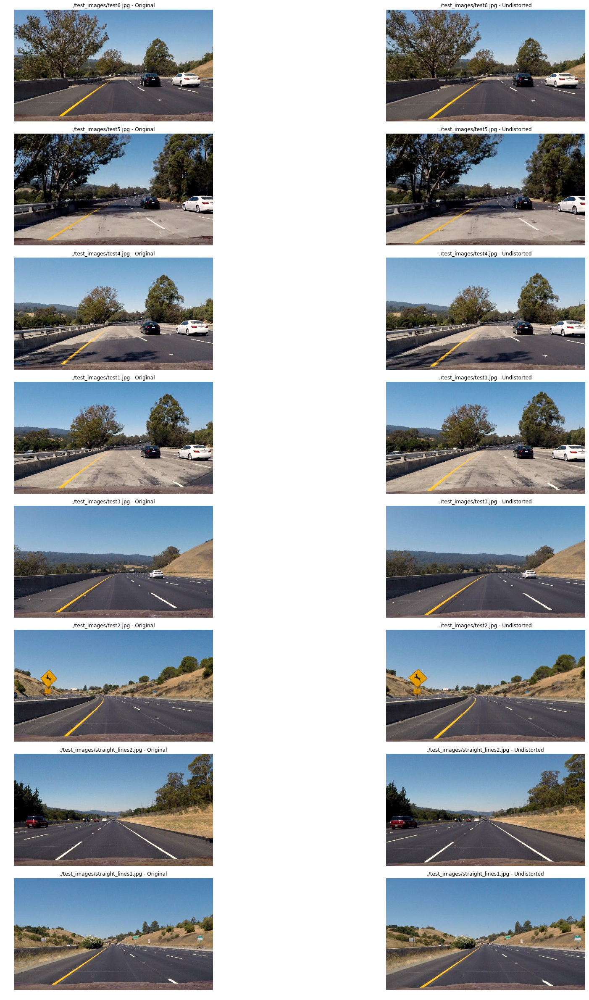

In [26]:
test_images = glob.glob('./test_images/*.jpg')

undistorted_images = []
f, axes = plt.subplots(8, 2, figsize=(24, 36))
f.tight_layout()
for row, fname in enumerate(test_images):
    img = cv2.imread(fname)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    undistorted = cv2.undistort(img, mtx, dist, None, mtx)
    axes[row, 0].set_title("{0} - {1}".format(fname, "Original"))
    axes[row, 0].imshow(img)
    axes[row, 0].axis('off')
    axes[row, 1].set_title("{0} - {1}".format(fname, "Undistorted"))
    axes[row, 1].imshow(undistorted)
    axes[row, 1].axis('off')
    undistorted_images.append(undistorted)


plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
cv2.destroyAllWindows()

## Color Space

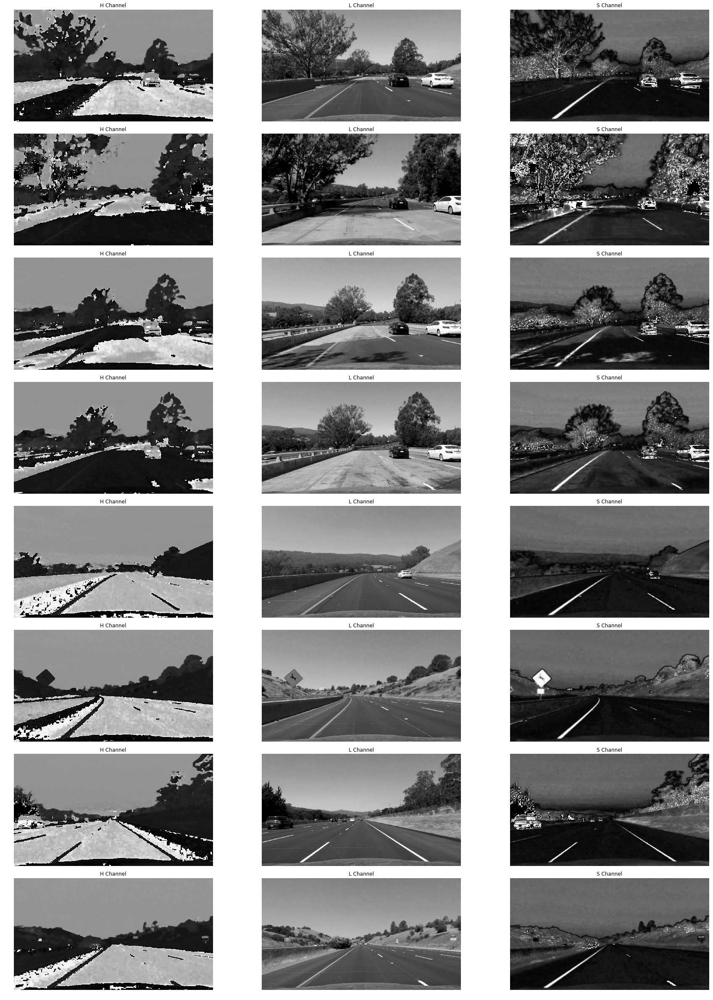

In [28]:
f, axes = plt.subplots(8, 3, figsize=(24, 36))
f.tight_layout()
for row, img in enumerate(undistorted_images):
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    H = hls[:, :, 0]
    L = hls[:, :, 1]
    S = hls[:, :, 2]
    axes[row, 0].set_title("H Channel")
    axes[row, 0].imshow(H, cmap='gray')
    axes[row, 0].axis('off')
    axes[row, 1].set_title("L Channel")
    axes[row, 1].imshow(L, cmap='gray')
    axes[row, 1].axis('off')
    axes[row, 2].set_title("S Channel")
    axes[row, 2].imshow(S, cmap='gray')
    axes[row, 2].axis('off')

plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    

S channel is best to find lane.

## Sobel

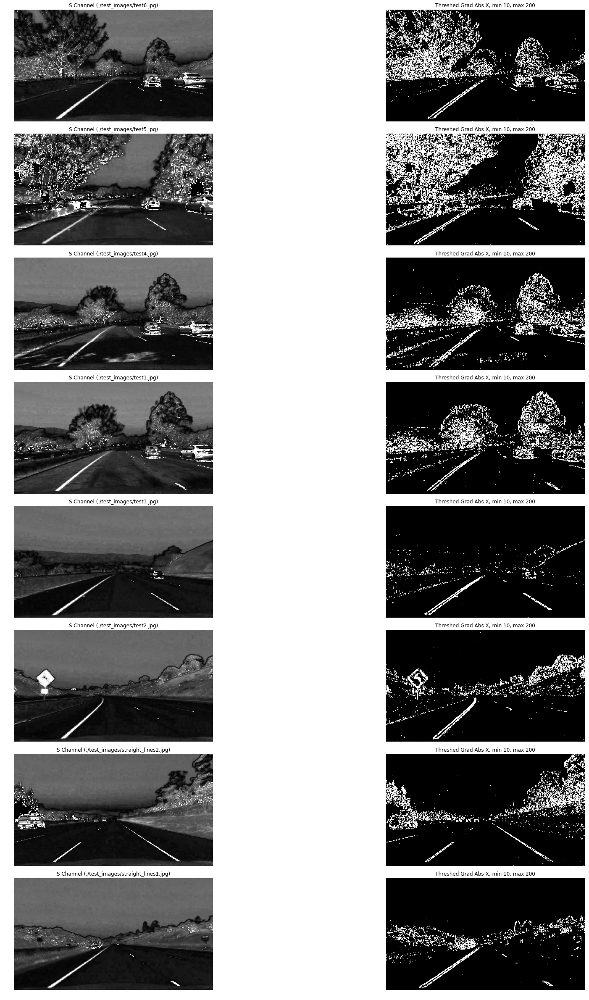

In [47]:
def abs_thresh(img, orient='x', sobel_kernel=3, thresh=(0, 255)):
    # Apply x or y gradient with the OpenCV Sobel() function
    # and take the absolute value
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel))
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255 * abs_sobel / np.max(abs_sobel))
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    # Here I'm using inclusive (>=, <=) thresholds, but exclusive is ok too
    binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    # Return the result
    return binary_output

f, axes = plt.subplots(8, 2, figsize=(24, 36))
f.tight_layout()
for row, img in enumerate(undistorted_images):
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    S = hls[:, :, 2]
    threshed = abs_thresh(S, thresh=(10, 200))
    axes[row, 0].set_title("S Channel - {0}".format(test_images[row]))
    axes[row, 0].imshow(S, cmap='gray')
    axes[row, 0].axis('off')
    axes[row, 1].set_title("Threshed Grad Abs X, min 10, max 200")
    axes[row, 1].imshow(threshed, cmap='gray')
    axes[row, 1].axis('off')

plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

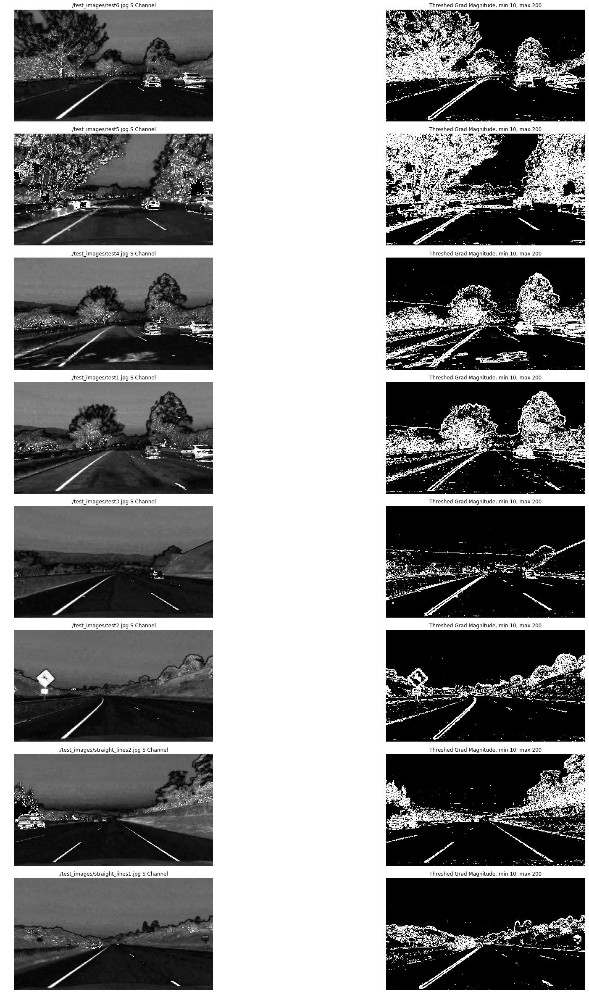

In [45]:
# Define a function to return the magnitude of the gradient
# for a given sobel kernel size and threshold values
def mag_thresh(img, sobel_kernel=3, thresh=(0, 255)):
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag) / 255
    gradmag = (gradmag / scale_factor).astype(np.uint8)
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= thresh[0]) & (gradmag <= thresh[1])] = 1

    # Return the binary image
    return binary_output

f, axes = plt.subplots(8, 2, figsize=(24, 36))
f.tight_layout()
for row, img in enumerate(undistorted_images):
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    S = hls[:, :, 2]
    threshed = mag_thresh(S, thresh=(10, 200))
    axes[row, 0].set_title("S Channel - {0}".format(test_images[row]))
    axes[row, 0].imshow(S, cmap='gray')
    axes[row, 0].axis('off')
    axes[row, 1].set_title("Threshed Grad Magnitude, min 10, max 200")
    axes[row, 1].imshow(threshed, cmap='gray')
    axes[row, 1].axis('off')

plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

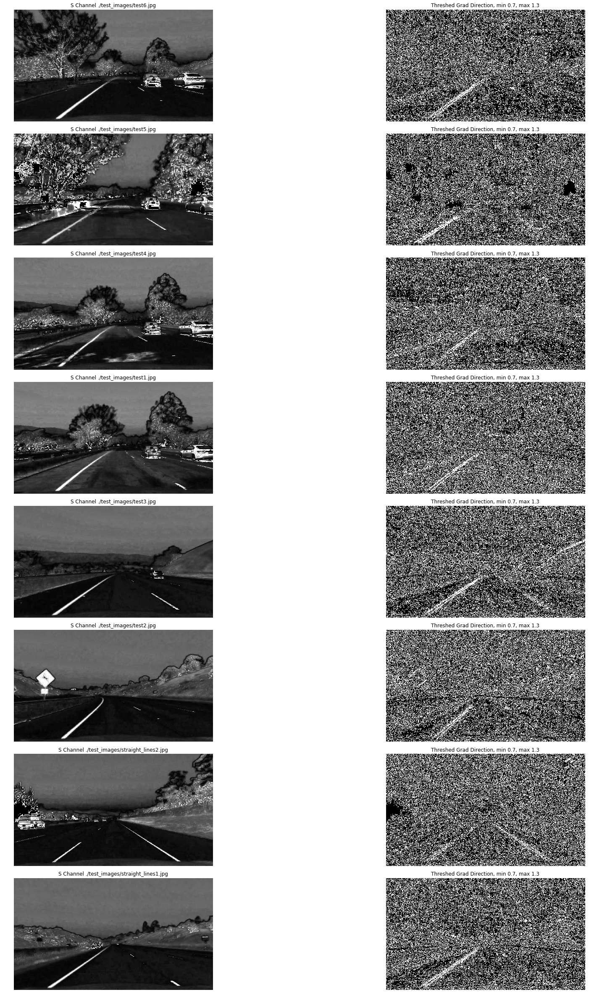

In [46]:
def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi / 2)):
    # Calculate the x and y gradients
    sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the gradient direction,
    # apply a threshold, and create a binary image result
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    binary_output = np.zeros_like(absgraddir)
    binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1

    # Return the binary image
    return binary_output


f, axes = plt.subplots(8, 2, figsize=(24, 36))
f.tight_layout()
for row, img in enumerate(undistorted_images):
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    S = hls[:, :, 2]
    threshed = dir_threshold(S, thresh=(0.7, 1.3))
    axes[row, 0].set_title("S Channel - {0}".format(test_images[row]))
    axes[row, 0].imshow(S, cmap='gray')
    axes[row, 0].axis('off')
    axes[row, 1].set_title("Threshed Grad Direction, min 0.7, max 1.3")
    axes[row, 1].imshow(threshed, cmap='gray')
    axes[row, 1].axis('off')

plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

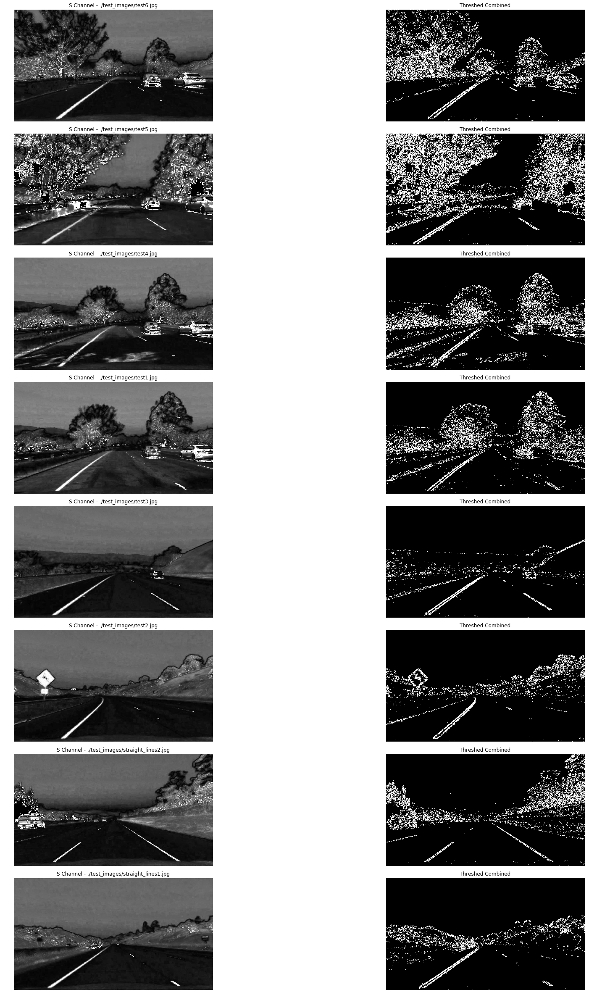

In [71]:
combined_images = []
def combined(img):
    gradX = abs_thresh(img, orient='x', thresh=(10, 200))
    gradY = abs_thresh(img, orient='y', thresh=(10, 200))
    mag = mag_thresh(img, thresh=(10, 200))
    direction = dir_threshold(S, thresh=(0.7, 1.3))
    combined = np.zeros_like(gradX) 
    combined[((gradX == 1) & (gradY == 1)) | ((mag == 1) & (direction == 1))] = 1
    return combined

f, axes = plt.subplots(8, 2, figsize=(24, 36))
f.tight_layout()
for row, img in enumerate(undistorted_images):
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    S = hls[:, :, 2]
    threshed = combined(S)
    axes[row, 0].set_title("S Channel - {0}".format(test_images[row]))
    axes[row, 0].imshow(S, cmap='gray')
    axes[row, 0].axis('off')
    axes[row, 1].set_title("Threshed Combined")
    axes[row, 1].imshow(threshed, cmap='gray')
    axes[row, 1].axis('off')
    combined_images.append(threshed)

plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## Perspective Transform

Text(0.5,1,'Unwarped Image')

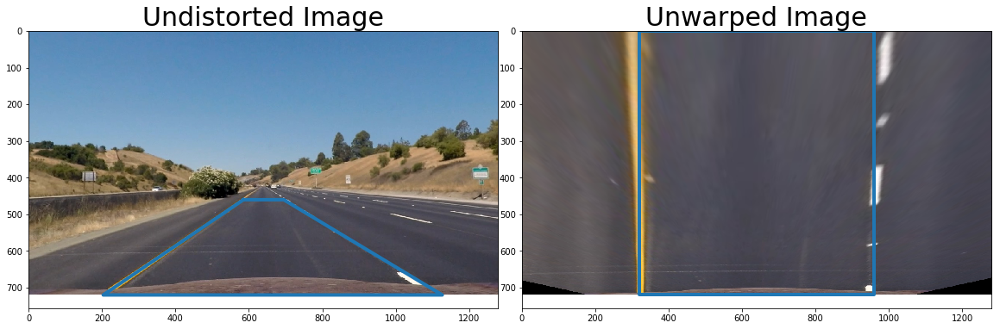

In [68]:
def unwarp(img, src, dst):
    h, w = img.shape[:2]
    # use cv2.getPerspectiveTransform() to get M, the transform matrix, and Minv, the inverse
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    # use cv2.warpPerspective() to warp your image to a top-down view
    warped = cv2.warpPerspective(img, M, (w, h), flags=cv2.INTER_LINEAR)
    return warped, M, Minv

# use the straight line image for this
undistorted = undistorted_images[-1]
h, w = undistorted.shape[:2]

# define source and destination points for transform
src = np.float32([(585, 460),
                  (203, 720),
                  (1127, 720),
                  (695, 460)])
dst = np.float32([(320, 0),
                  (320, 720),
                  (960, 720),
                  (960, 0)])

srcX = [585, 203, 1127, 695, 585]
srcY = [460, 720, 720, 460, 460]
dstX = [320, 320, 960, 960, 320]
dstY = [0, 720, 720, 0, 0]

unwarpped, M, Minv = unwarp(undistorted, src, dst)

# Visualize unwarp
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
f.subplots_adjust(hspace=.2, wspace=.05)
ax1.imshow(undistorted)
ax1.plot(srcX, srcY, lw=4)
ax1.set_title('Undistorted Image', fontsize=30)
ax2.imshow(unwarpped)
ax2.plot(dstX, dstY, lw=4)
ax2.set_title('Unwarped Image', fontsize=30)


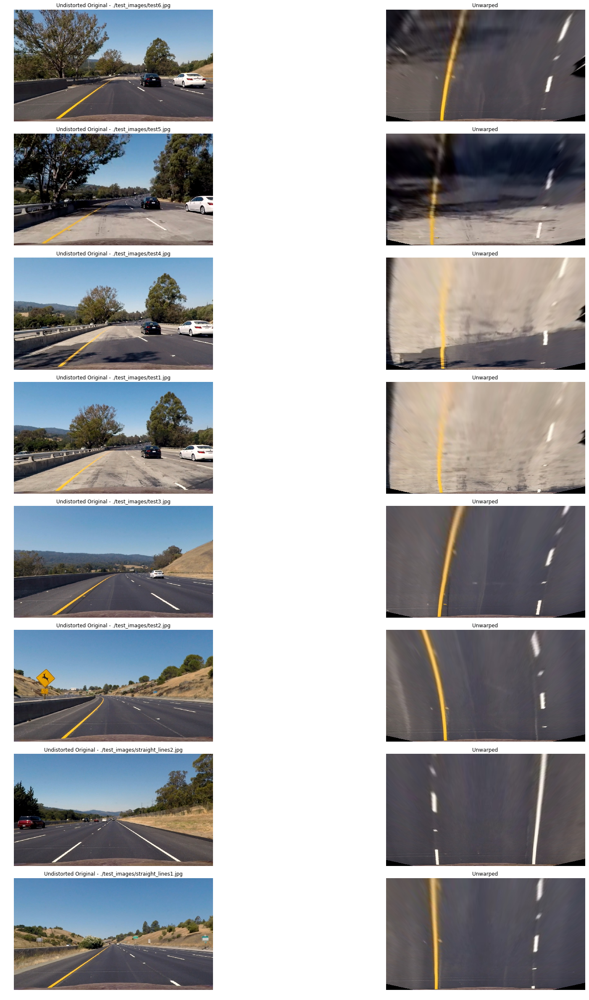

In [70]:

f, axes = plt.subplots(8, 2, figsize=(24, 36))
f.tight_layout()
for row, undistorted in enumerate(undistorted_images):
    unwarped, M, Minv = unwarp(undistorted, src, dst)
    axes[row, 0].set_title("Undistorted Original - {0}".format(test_images[row]))
    axes[row, 0].imshow(undistorted)
    axes[row, 0].axis('off')
    axes[row, 1].set_title("Unwarped")
    axes[row, 1].imshow(unwarped)
    axes[row, 1].axis('off')

plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## Apply M to combined grad

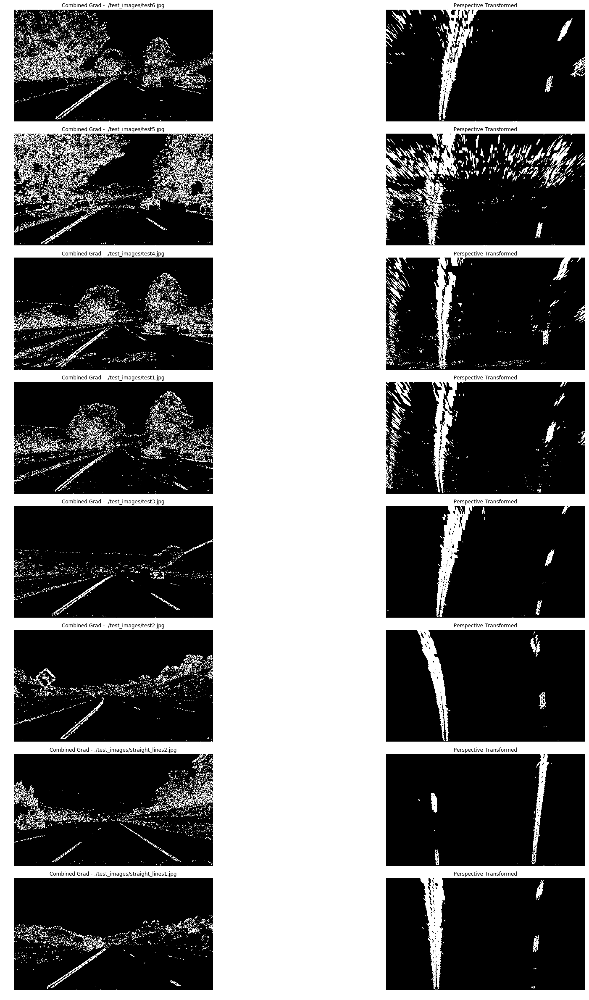

In [74]:
f, axes = plt.subplots(8, 2, figsize=(24, 36))
f.tight_layout()
for row, img in enumerate(combined_images):
    unwarped = cv2.warpPerspective(img, M, (img.shape[1], img.shape[0]))
    axes[row, 0].set_title("Combined Grad - {0}".format(test_images[row]))
    axes[row, 0].imshow(img, cmap='gray')
    axes[row, 0].axis('off')
    axes[row, 1].set_title("Perspective Transformed")
    axes[row, 1].imshow(unwarped, cmap='gray')
    axes[row, 1].axis('off')

plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## Finding lane with sliding window

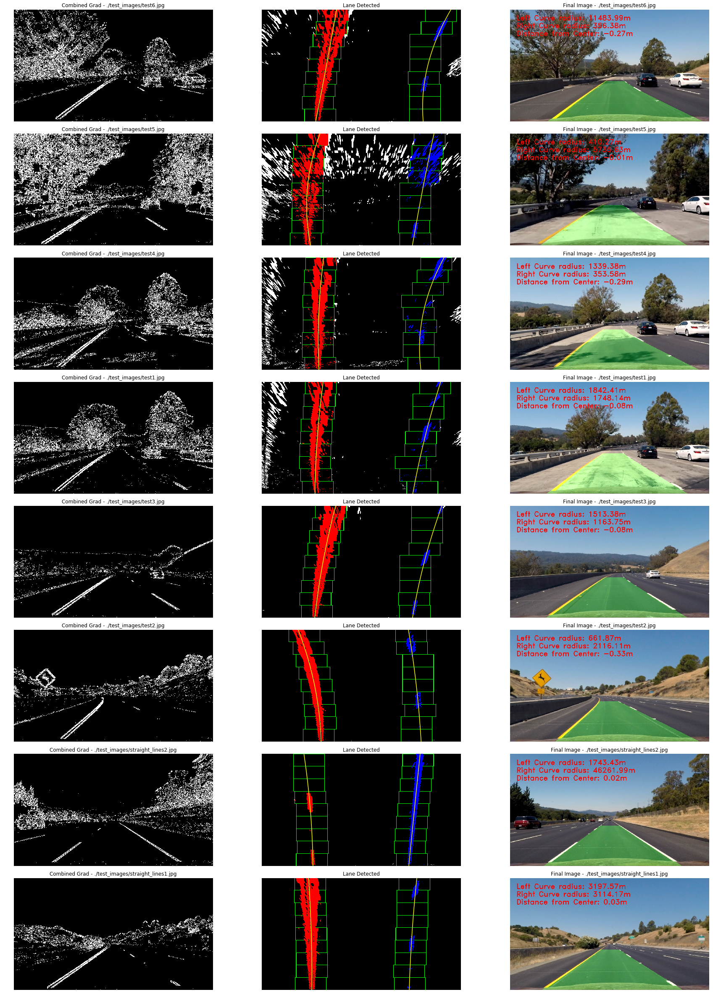

In [108]:
def find_line(binary_warped, ax, nwindows=9, margin=100, minpix=50):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
    
    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
    
    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Visualization
    ploty = np.linspace(0, binary_warped.shape[0] - 1, binary_warped.shape[0])
    left_fitx = left_fit[0] * ploty**2 + left_fit[1] * ploty + left_fit[2]
    right_fitx = right_fit[0] * ploty**2 + right_fit[1] * ploty + right_fit[2]
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    ax.imshow(out_img)
    ax.set_title("Lane Detected")
    ax.plot(left_fitx, ploty, color='yellow')
    ax.plot(right_fitx, ploty, color='yellow')
    ax.axis('off')
    return (left_fit, right_fit, leftx, lefty, rightx, righty)

def draw_line(original_img, binary_warped, left_fit, right_fit):
    new_img = np.copy(original_img)
    if left_fit is None or right_fit is None:
        return new_img
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    h = original_img.shape[0]
    ploty = np.linspace(0, h-1, h)
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (w, h)) 
    # Combine the result with the original image
    new_img = cv2.addWeighted(new_img, 1, newwarp, 0.3, 0)    
    return new_img

def draw_curvature(original_img, binary_warped, left_fit, right_fit, leftx, lefty, rightx, righty):
    new_img = np.copy(original_img)
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    left_curverad, right_curverad, center_dist = (0, 0, 0)
    h = binary_warped.shape[0]
    ploty = np.linspace(0, h-1, h)
    y_eval = np.max(ploty)  
    
    if len(leftx) != 0 and len(rightx) != 0:
        # Fit new polynomials to x,y in world space
        left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
        right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
        # Calculate the new radii of curvature
        left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
        right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
        # Now our radius of curvature is in meters
    
    # Distance from center is image x midpoint - mean of l_fit and r_fit intercepts 
    if right_fit is not None and left_fit is not None:
        car_position = binary_warped.shape[1]/2
        l_fit_x_int = left_fit[0]*h**2 + left_fit[1]*h + left_fit[2]
        r_fit_x_int = right_fit[0]*h**2 + right_fit[1]*h + right_fit[2]
        lane_center_position = (r_fit_x_int + l_fit_x_int) /2
        center_dist = (car_position - lane_center_position) * xm_per_pix
    font = cv2.FONT_HERSHEY_DUPLEX
    left_text = 'Left Curve radius: {:04.2f}'.format(left_curverad) + 'm'
    right_text = 'Right Curve radius: {:04.2f}'.format(right_curverad) + 'm'
    cdist_text = 'Distance from Center: {:04.2f}'.format(center_dist) + 'm'
    new_img = cv2.putText(new_img, left_text, (40,70), font, 1.5, (255,0,0), 2, cv2.LINE_AA)
    new_img = cv2.putText(new_img, right_text, (40,120), font, 1.5, (255,0,0), 2, cv2.LINE_AA)
    new_img = cv2.putText(new_img, cdist_text, (40,170), font, 1.5, (255,0,0), 2, cv2.LINE_AA)
    return new_img


f, axes = plt.subplots(8, 3, figsize=(24, 36))
f.tight_layout()
for row, img in enumerate(combined_images):
    unwarped = cv2.warpPerspective(img, M, (img.shape[1], img.shape[0]))
    axes[row, 0].set_title("Combined Grad - {0}".format(test_images[row]))
    axes[row, 0].imshow(img, cmap='gray')
    axes[row, 0].axis('off')
    left_fit, right_fit, leftx, lefty, rightx, righty = find_line(unwarped, axes[row, 1])
    original_img = undistorted_images[row]
    axes[row, 2].set_title("Final Image - {0}".format(test_images[row]))
    axes[row, 2].axis('off')
    line_img = draw_line(original_img, img, left_fit, right_fit)
    final_img = draw_curvature(line_img, img, left_fit, right_fit, leftx, lefty, rightx, righty)
    axes[row, 2].imshow(final_img)
        

plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)



## Complete Image Processing Pipeline

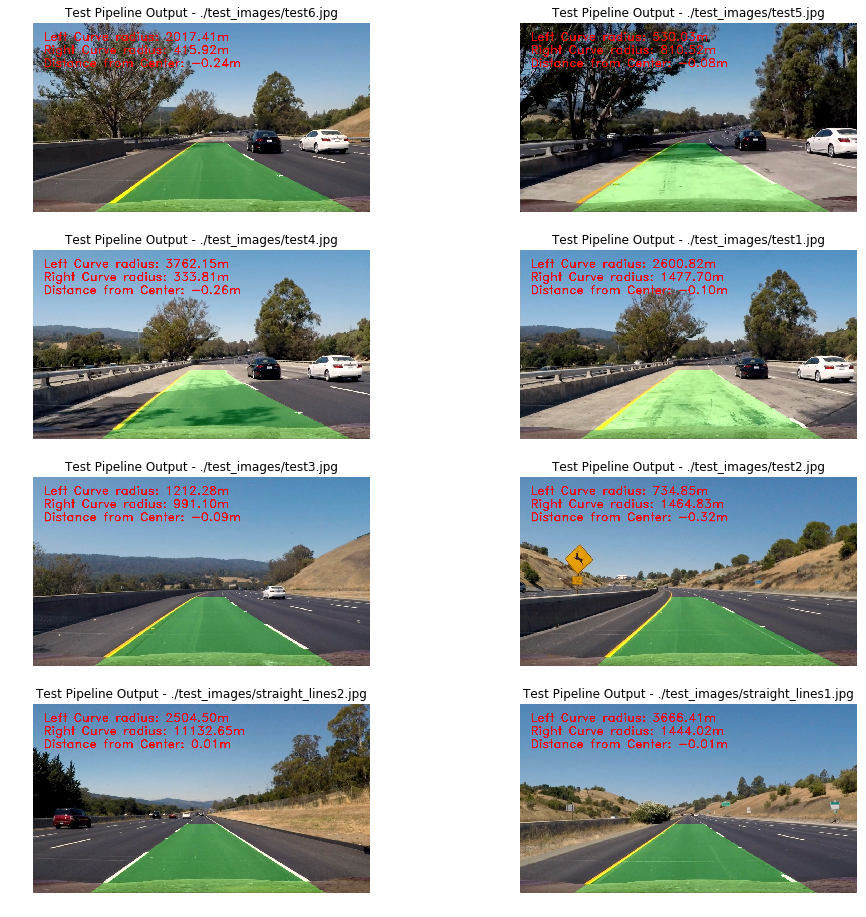

In [111]:
def process_image(img):
    # undistort
    undistorted = cv2.undistort(img, mtx, dist, None, mtx)
    
    # compute threshed grads for S channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    S = hls[:, :, 2]
    threshed = combined(S)
    
    # perspective transformation to bird-eye
    unwarped = cv2.warpPerspective(threshed, M, (img.shape[1], img.shape[0]))

    # find line
    left_fit, right_fit, leftx, lefty, rightx, righty = find_line(unwarped, axes[row, 1])
    
    # draw line area in original image
    line_img = draw_line(img, unwarped, left_fit, right_fit)
    
    # add curvature in the image 
    final_img = draw_curvature(line_img, unwarped, left_fit, right_fit, leftx, lefty, rightx, righty)
 
    return final_img

    
def pipeline(fname):
    # load original image
    img = cv2.imread(fname)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return process_image(img)

test_images = glob.glob('./test_images/*.jpg')

plt.figure(figsize=(16, 16))
i = 1

for fname in test_images:
    processed = pipeline(fname)    
    plt.subplot(4, 2, i)
    i += 1
    plt.axis('off')
    plt.title("Test Pipeline Output - {0}".format(fname))
    plt.imshow(processed)

plt.show()





## Process Video

In [113]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML

video_output = 'project_video_output.mp4'
video_input = VideoFileClip('project_video.mp4')
processed_video = video_input.fl_image(process_image)
%time processed_video.write_videofile(video_output, audio=False)

[MoviePy] >>>> Building video project_video_output.mp4
[MoviePy] Writing video project_video_output.mp4


100%|█████████▉| 1260/1261 [05:28<00:00,  3.62it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_output.mp4 

CPU times: user 5min 51s, sys: 58.3 s, total: 6min 49s
Wall time: 5min 29s


In [114]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML

video_output = 'challenge_video_out.mp4'
video_input = VideoFileClip('challenge_video.mp4')
processed_video = video_input.fl_image(process_image)
%time processed_video.write_videofile(video_output, audio=False)

[MoviePy] >>>> Building video challenge_video_out.mp4
[MoviePy] Writing video challenge_video_out.mp4


100%|██████████| 485/485 [02:11<00:00,  3.63it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: challenge_video_out.mp4 

CPU times: user 2min 19s, sys: 23.2 s, total: 2min 42s
Wall time: 2min 11s
